<a href="https://colab.research.google.com/github/MaferLedmar/Actividad6_Regresiones/blob/main/Actividad_6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%pip install funpymodeling

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from funpymodeling.exploratory import freq_tbl

In [ ]:
from google.colab import files
files.upload()

Saving BD_Socio formador (TrainingDataComplete).csv to BD_Socio formador (TrainingDataComplete).csv


{'BD_Socio formador (TrainingDataComplete).csv': b'Id,Income,Age,Experience,Married/Single,House_Ownership,Car_Ownership,Profession,CITY,STATE,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS,Risk_Flag\r\n1,1303834,23,3,single,rented,no,Mechanical_engineer,Rewa,Madhya_Pradesh,3,13,0\r\n2,7574516,40,10,single,rented,no,Software_Developer,Parbhani,Maharashtra,9,13,0\r\n3,3991815,66,4,married,rented,no,Technical_writer,Alappuzha,Kerala,4,10,0\r\n4,6256451,41,2,single,rented,yes,Software_Developer,Bhubaneswar,Odisha,2,12,1\r\n5,5768871,47,11,single,rented,no,Civil_servant,Tiruchirappalli[10],Tamil_Nadu,3,14,1\r\n6,6915937,64,0,single,rented,no,Civil_servant,Jalgaon,Maharashtra,0,12,0\r\n7,3954973,58,14,married,rented,no,Librarian,Tiruppur,Tamil_Nadu,8,12,0\r\n8,1706172,33,2,single,rented,no,Economist,Jamnagar,Gujarat,2,14,0\r\n9,7566849,24,17,single,rented,yes,Flight_attendant,Kota[6],Rajasthan,11,11,0\r\n10,8964846,23,12,single,rented,no,Architect,Karimnagar,Telangana,5,13,0\r\n11,4634680,78,7,single,re

In [ ]:
data=pd.read_csv('BD_Socio formador (TrainingDataComplete).csv')
data1 = data.copy()
data1 = data1.astype(object)
data1 = data1.drop(columns = ['Id', 'Income', 'STATE', 'Car_Ownership'])

In [ ]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 252000 entries, 0 to 251999
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   Age                252000 non-null  object
 1   Experience         252000 non-null  object
 2   Married/Single     252000 non-null  object
 3   House_Ownership    252000 non-null  object
 4   Profession         252000 non-null  object
 5   CITY               252000 non-null  object
 6   CURRENT_JOB_YRS    252000 non-null  object
 7   CURRENT_HOUSE_YRS  252000 non-null  object
 8   Risk_Flag          252000 non-null  object
dtypes: object(9)
memory usage: 17.3+ MB


#Extracción de características

In [ ]:
#se definen los rangos de edad en los cuáles se va a comparar cada registro
age_bins = [20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80]

#se definen las etiquetas para cada rango de edad
age_label = [20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]

#el código asigna la edad del registro con el rango que corresponde de los definidos anteriormente, y dependiendo del correspondiente,
#asigna la etiqueta que corresponde al rango
data1['Age_Range'] = pd.cut(data1['Age'], age_bins, labels = age_label)
data1

,Age,Experience,Married/Single,House_Ownership,Profession,CITY,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS,Risk_Flag,Age_Range
0,23,3,single,rented,Mechanical_engineer,Rewa,3,13,0,20
1,40,10,single,rented,Software_Developer,Parbhani,9,13,0,35
2,66,4,married,rented,Technical_writer,Alappuzha,4,10,0,65
3,41,2,single,rented,Software_Developer,Bhubaneswar,2,12,1,40
4,47,11,single,rented,Civil_servant,Tiruchirappalli[10],3,14,1,45
...,...,...,...,...,...,...,...,...,...,...
251995,43,13,single,rented,Surgeon,Kolkata,6,11,0,40
251996,26,10,single,rented,Army_officer,Rewa,6,11,0,25
251997,46,7,single,rented,Design_Engineer,Kalyan-Dombivli,7,12,0,45
251998,45,0,single,rented,Graphic_Designer,Pondicherry,0,10,0,40


In [ ]:
tabla1 = freq_tbl(data1['Age_Range'])

#Ajusto el índice de mi dataframe
tabla1 = tabla1.set_index('Age_Range')

tabla1 = tabla1.sort_index()
tabla1

,frequency,percentage,cumulative_perc
Age_Range,,,
20,21826,0.086611,0.525655
25,21831,0.086631,0.439044
30,22069,0.087575,0.265492
35,19423,0.077075,0.930710
40,21595,0.085694,0.611349
45,21904,0.086921,0.352413
50,20432,0.081079,0.774131
55,22108,0.087730,0.177917
60,20589,0.081702,0.693052


Text(0, 0.5, 'Frecuencia')

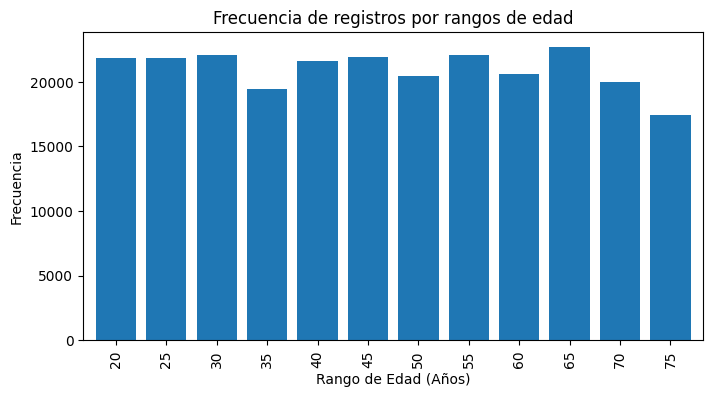

In [ ]:
#Realizamos gráfico de barras del df filtrado
tabla1['frequency'].plot(kind= 'bar', width=0.8, figsize=(8,4))
plt.title("Frecuencia de registros por rangos de edad")
plt.xlabel("Rango de Edad (Años)")
plt.ylabel("Frecuencia")

In [ ]:
#se definen los rangos de edad en los cuáles se va a comparar cada registro
age_bins = [-1, 1, 4, 8, 12, 16, 20]

#se definen las etiquetas para cada rango de edad
age_label = [0, 4, 8, 12, 16, 20]

#el código asigna la edad del registro con el rango que corresponde de los definidos anteriormente, y dependiendo del correspondiente,
#asigna la etiqueta que corresponde al rango
data1['Experience_Range'] = pd.cut(data1['Experience'], age_bins, labels = age_label)
data1

,Age,Experience,Married/Single,House_Ownership,Profession,CITY,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS,Risk_Flag,Age_Range,Experience_Range
0,23,3,single,rented,Mechanical_engineer,Rewa,3,13,0,20,4
1,40,10,single,rented,Software_Developer,Parbhani,9,13,0,35,12
2,66,4,married,rented,Technical_writer,Alappuzha,4,10,0,65,4
3,41,2,single,rented,Software_Developer,Bhubaneswar,2,12,1,40,4
4,47,11,single,rented,Civil_servant,Tiruchirappalli[10],3,14,1,45,12
...,...,...,...,...,...,...,...,...,...,...,...
251995,43,13,single,rented,Surgeon,Kolkata,6,11,0,40,16
251996,26,10,single,rented,Army_officer,Rewa,6,11,0,25,12
251997,46,7,single,rented,Design_Engineer,Kalyan-Dombivli,7,12,0,45,8
251998,45,0,single,rented,Graphic_Designer,Pondicherry,0,10,0,40,0


In [ ]:
tabla2 = freq_tbl(data1['Experience_Range'])


#Ajusto el índice de mi dataframe
tabla2 = tabla2.set_index('Experience_Range')
tabla2

tabla2 = tabla2.sort_index()
tabla2

,frequency,percentage,cumulative_perc
Experience_Range,,,
0,22618,0.089754,1.000000
4,34963,0.138742,0.910246
8,48181,0.191194,0.580310
12,49688,0.197175,0.197175
16,48181,0.191194,0.771504
20,48369,0.191940,0.389115


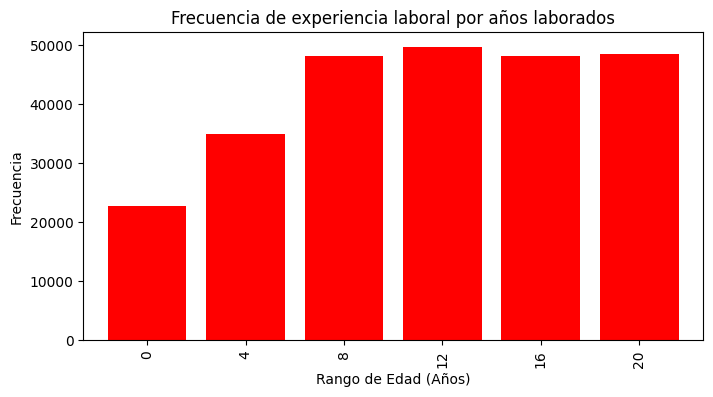

In [ ]:
#Realizamos gráfico de barras del df filtrado
tabla2['frequency'].plot(kind= 'bar', width=0.8, color = 'red', figsize=(8,4))
plt.title("Frecuencia de experiencia laboral por años laborados")
plt.xlabel("Rango de Edad (Años)")
plt.ylabel("Frecuencia")
plt.show()

In [ ]:
tabla3 = freq_tbl(data1['Married/Single'])

#Ajusto el índice de mi dataframe
tabla3 = tabla3.set_index('Married/Single')
tabla3

,frequency,percentage,cumulative_perc
Married/Single,,,
single,226272,0.897905,0.897905
married,25728,0.102095,1.000000


Text(0.5, 1.0, 'Frecuencia de registros de personas casadas y solteras')

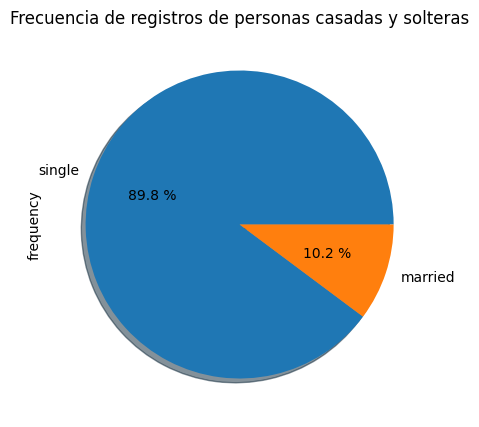

In [ ]:
tabla3["frequency"].plot(kind='pie', figsize=(10,5), shadow=True, autopct="%0.1f %%")
plt.title('Frecuencia de registros de personas casadas y solteras')

In [ ]:
tabla4 = freq_tbl(data1['House_Ownership'])

#Ajusto el índice de mi dataframe
tabla4 = tabla4.set_index('House_Ownership')
tabla4

,frequency,percentage,cumulative_perc
House_Ownership,,,
rented,231898,0.920230,0.920230
owned,12918,0.051262,0.971492
norent_noown,7184,0.028508,1.000000


Text(0.5, 1.0, 'Frecuencia de registros de personas con casa propia o rentada')

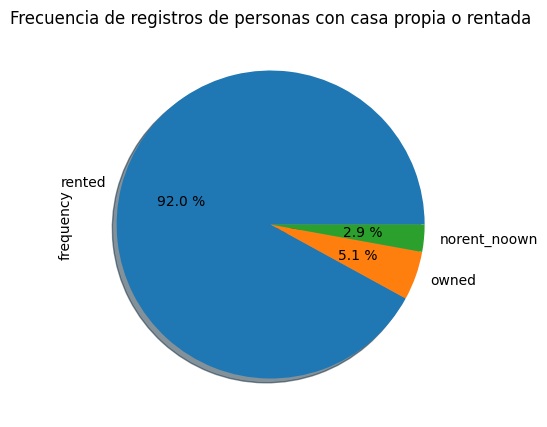

In [ ]:
tabla4["frequency"].plot(kind='pie', figsize=(10,5), shadow=True, autopct="%0.1f %%")
plt.title('Frecuencia de registros de personas con casa propia o rentada')

In [ ]:
tabla5 = freq_tbl(data1['Profession'])


#Ajusto el índice de mi dataframe
tabla5 = tabla5.set_index('Profession')
tabla5= tabla5.head(10)
tabla5

,frequency,percentage,cumulative_perc
Profession,,,
Physician,5957,0.023639,0.023639
Statistician,5806,0.023040,0.046679
Web_designer,5397,0.021417,0.068095
Psychologist,5390,0.021389,0.089484
Computer_hardware_engineer,5372,0.021317,0.110802
Drafter,5359,0.021266,0.132067
Magistrate,5357,0.021258,0.153325
Fashion_Designer,5304,0.021048,0.174373
Air_traffic_controller,5281,0.020956,0.195329


Text(0, 0.5, 'Frecuencia')

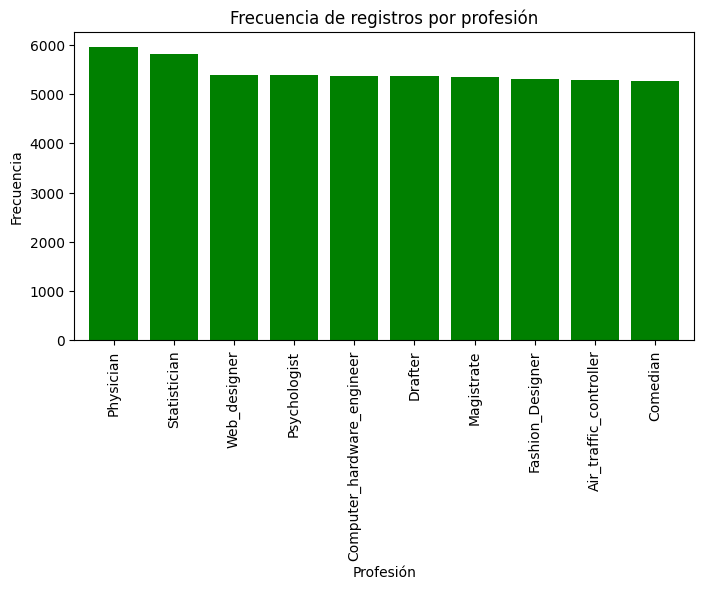

In [ ]:
#Realizamos gráfico de barras del df filtrado
tabla5['frequency'].plot(kind= 'bar', width=0.8, figsize=(8,4), color = 'green')
plt.title("Frecuencia de registros por profesión")
plt.xlabel("Profesión")
plt.ylabel("Frecuencia")

In [ ]:
tabla6 = freq_tbl(data1['CITY'])


#Ajusto el índice de mi dataframe
tabla6 = tabla6.set_index('CITY')
tabla6= tabla6.head(10)
tabla6

,frequency,percentage,cumulative_perc
CITY,,,
Vijayanagaram,1259,0.004996,0.004996
Bhopal,1208,0.004794,0.009790
Bulandshahr,1185,0.004702,0.014492
Saharsa[29],1180,0.004683,0.019175
Vijayawada,1172,0.004651,0.023825
Srinagar,1136,0.004508,0.028333
Indore,1130,0.004484,0.032817
New_Delhi,1098,0.004357,0.037175
Hajipur[31],1098,0.004357,0.041532


Text(0.5, 1.0, 'Frecuencia de ciudades con la mayor cantidad de registros')

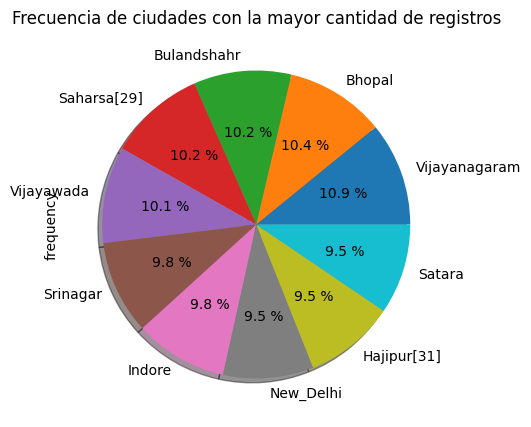

In [ ]:
tabla6["frequency"].plot(kind='pie', figsize=(10,5), shadow=True, autopct="%0.1f %%")
plt.title('Frecuencia de ciudades con la mayor cantidad de registros')

In [ ]:
tabla7 = freq_tbl(data1['CURRENT_JOB_YRS'])


#Ajusto el índice de mi dataframe
tabla7 = tabla7.set_index('CURRENT_JOB_YRS')
tabla7

,frequency,percentage,cumulative_perc
CURRENT_JOB_YRS,,,
3,29460,0.116905,0.116905
4,28339,0.112456,0.229361
5,25091,0.099567,0.328929
6,23491,0.093218,0.422147
7,19925,0.079067,0.501214
8,18874,0.074897,0.576111
9,17132,0.067984,0.644095
10,15768,0.062571,0.706667
11,13595,0.053948,0.760615


Text(0.5, 1.0, 'Frecuencia de registros por años laborados en el trabajo actual')

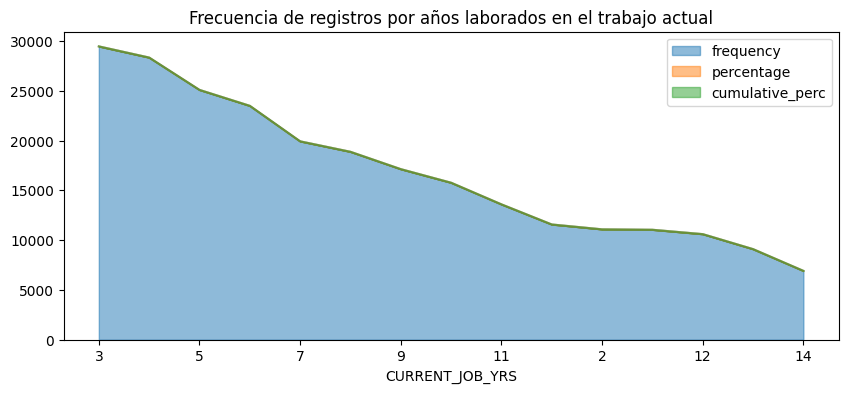

In [ ]:
tabla7.plot(kind='area', figsize=(10,4),alpha = 0.5)
plt.title('Frecuencia de registros por años laborados en el trabajo actual')

In [ ]:
tabla8 = freq_tbl(data1['CURRENT_HOUSE_YRS'])


#Ajusto el índice de mi dataframe
tabla8 = tabla8.set_index('CURRENT_HOUSE_YRS')
tabla8

,frequency,percentage,cumulative_perc
CURRENT_HOUSE_YRS,,,
11,51873,0.205845,0.205845
12,51791,0.205520,0.411365
13,50659,0.201028,0.612393
14,49003,0.194456,0.806849
10,48674,0.193151,1.000000


Text(0.5, 1.0, 'Frecuencia de registros por año viviendo en el domicilio actual')

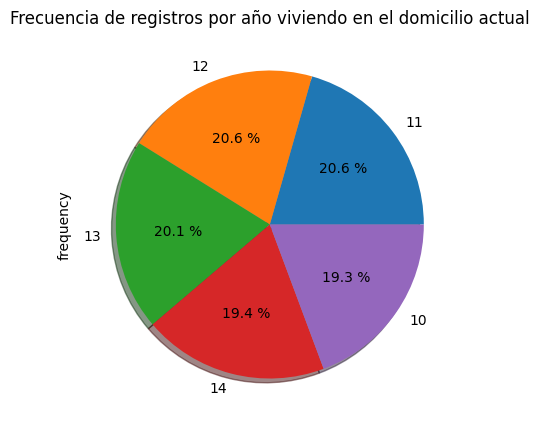

In [ ]:
tabla8["frequency"].plot(kind='pie', figsize=(10,5), shadow=True, autopct="%0.1f %%")
plt.title('Frecuencia de registros por año viviendo en el domicilio actual')

In [ ]:
tabla9 = freq_tbl(data1['Risk_Flag'])


#Ajusto el índice de mi dataframe
tabla9 = tabla9.set_index('Risk_Flag')
tabla9

,frequency,percentage,cumulative_perc
Risk_Flag,,,
0,221004,0.877,0.877
1,30996,0.123,1.000


Text(0.5, 1.0, 'Frecuencia de registros de personas candidatas o no al crédito')

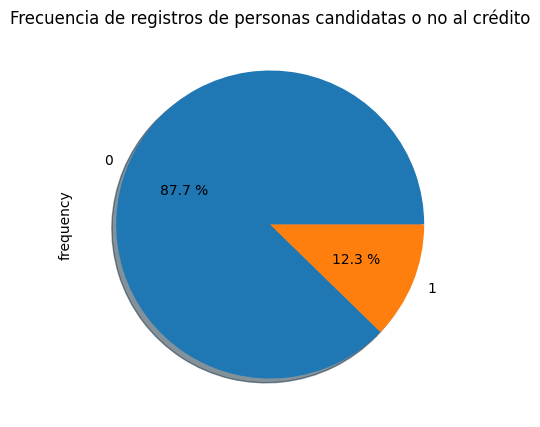

In [ ]:
tabla9["frequency"].plot(kind='pie', figsize=(10,5), shadow=True, autopct="%0.1f %%")
plt.title('Frecuencia de registros de personas candidatas o no al crédito')

#Análisis de correlación

In [ ]:
data2 = data.copy()
data2 = data2[['Income', 'Age', 'Experience', 'CURRENT_JOB_YRS', 'CURRENT_HOUSE_YRS', 'Risk_Flag']]
data2

,Income,Age,Experience,CURRENT_JOB_YRS,CURRENT_HOUSE_YRS,Risk_Flag
0,1303834,23,3,3,13,0
1,7574516,40,10,9,13,0
2,3991815,66,4,4,10,0
3,6256451,41,2,2,12,1
4,5768871,47,11,3,14,1
...,...,...,...,...,...,...
251995,8154883,43,13,6,11,0
251996,2843572,26,10,6,11,0
251997,4522448,46,7,7,12,0
251998,6507128,45,0,0,10,0


In [ ]:
Corr_Factors1 = data2.corr()
Corr_Factors1 = abs(Corr_Factors1)

<Axes: >

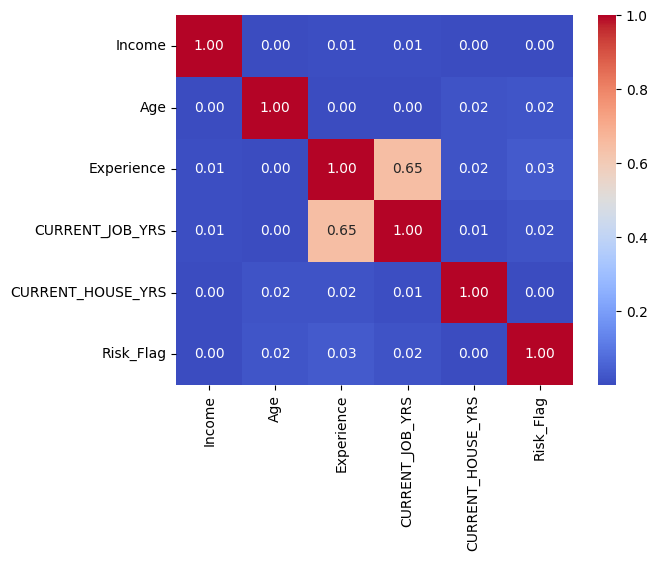

In [ ]:
# COEFICIENTES DE COORELACIÓN
Heat_Map1 = sns.heatmap(Corr_Factors1, cmap = 'coolwarm', annot = True, fmt = '.2f')
Heat_Map1

<Axes: >

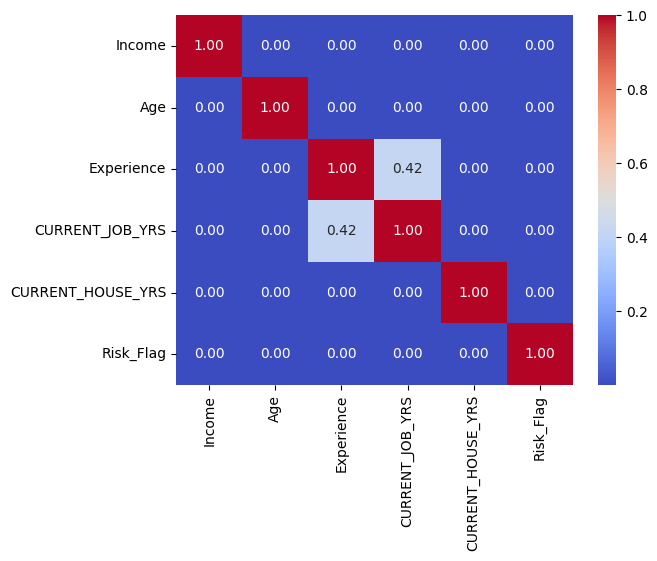

In [ ]:
#COEFICIENTES DE DETERMINACIÓN
Heat_Map12 = sns.heatmap(Corr_Factors1**2, cmap = 'coolwarm', annot = True, fmt = '.2f')
Heat_Map12

In [ ]:
vars_Indep = data2[['CURRENT_JOB_YRS']]
var_Dep = data2['Experience']

from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X = vars_Indep, y = var_Dep)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

LinearRegression()

In [ ]:
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['CURRENT_JOB_YRS'], dtype=object),
 'n_features_in_': 1,
 'coef_': array([1.06339513]),
 'rank_': 1,
 'singular_': array([1830.80244488]),
 'intercept_': 3.3490225813747347}

#Modelo y = 1.06339513 x + 3.3490225813747347

#**MODELOS DE REGRESIÓN LINEAL MULTIPLE**

#Modelo para la variable Income

In [ ]:
#declaramos la variables dependientes e independientes para la regresion lineal
Vars_Indep = data2[['Age', 'Experience', 'CURRENT_JOB_YRS', 'CURRENT_HOUSE_YRS', 'Risk_Flag']]
Var_Dep = data2['Income']

#se define model como la funcion de regresion lineal
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [ ]:
#Ajustamos el modelo con las variables antes de declararlas
model.fit(X = Vars_Indep, y = Var_Dep)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

LinearRegression()

In [ ]:
#Verificamos los coeficientes obtenidos para el modelo ajustado
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['Age', 'Experience', 'CURRENT_JOB_YRS', 'CURRENT_HOUSE_YRS',
        'Risk_Flag'], dtype=object),
 'n_features_in_': 5,
 'coef_': array([  -130.44083951,   1513.73716195,   3922.84601877,  -5170.61160001,
        -25640.98923558]),
 'rank_': 5,
 'singular_': array([8565.98426852, 3284.5692682 , 1281.99532295,  701.97703592,
         164.73040697]),
 'intercept_': 5028710.47863095}

#Modelo de regresión lineal mútiple para "INCOME":

INCOME = -130.44083951 (Age) + 1513.73716195 (Experience) + 3922.84601877 (CURRENT_JOB_YRS) - 5170.61160001 (CURRENT_HOUSE_YRS) - 25640.98923558 (Risk_Flag) + 5028710.47863095

In [ ]:
#Predecimos los valores de total de accidentes a partir de la variable 'alcohol'
y_pred = model.predict(X = data2[['Age', 'Experience', 'CURRENT_JOB_YRS', 'CURRENT_HOUSE_YRS', 'Risk_Flag']])
y_pred


#insertamos la columna de predicciones en el dataframe nuevo
data3 = pd.DataFrame()
data3.insert(0, 'predicciones_INCOME', y_pred)
data3

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


,predicciones_INCOME
0,4.974802e+06
1,5.006718e+06
2,4.990142e+06
3,4.946547e+06
4,4.952970e+06
...,...
251995,5.009440e+06
251996,5.007117e+06
251997,4.998719e+06
251998,4.971135e+06


#Modelo para la variable Age

In [ ]:
#declaramos la variables dependientes e independientes para la regresion lineal
Vars_Indep = data2[['Experience', 'CURRENT_HOUSE_YRS', 'Risk_Flag']]
Var_Dep = data2['Age']

#se define model como la funcion de regresion lineal
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [ ]:
#Ajustamos el modelo con las variables antes de declararlas
model.fit(X = Vars_Indep, y = Var_Dep)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

LinearRegression()

In [ ]:
#Verificamos los coeficientes obtenidos para el modelo ajustado
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['Experience', 'CURRENT_HOUSE_YRS', 'Risk_Flag'], dtype=object),
 'n_features_in_': 3,
 'coef_': array([-0.00422265, -0.24639731, -1.14034831]),
 'rank_': 3,
 'singular_': array([3013.30786893,  702.17142523,  164.77439691]),
 'intercept_': 53.09314133237175}

#Modelo de regresión lineal mútiple para "Age":

Age = -0.00422265 (Experience) -0.24639731 (CURRENT_HOUSE_YRS) -1.14034831 (Risk_Flag) + 53.09314133237175

In [ ]:
#Predecimos los valores de total de accidentes a partir de la variable 'alcohol'
y_pred = model.predict(X = data2[['Experience', 'CURRENT_HOUSE_YRS', 'Risk_Flag']])
y_pred


#insertamos la columna de predicciones en el dataframe nuevo
data3.insert(0, 'predicciones_Age', y_pred)
data3

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


,predicciones_Age,predicciones_INCOME
0,49.877308,4.974802e+06
1,49.847750,5.006718e+06
2,50.612278,4.990142e+06
3,48.987580,4.946547e+06
4,48.456782,4.952970e+06
...,...,...
251995,50.327877,5.009440e+06
251996,50.340544,5.007117e+06
251997,50.106815,4.998719e+06
251998,50.629168,4.971135e+06


#Modelo para la variable Experience

In [ ]:
#declaramos la variables dependientes e independientes para la regresion lineal
Vars_Indep = data2[['Income', 'Age', 'CURRENT_JOB_YRS', 'CURRENT_HOUSE_YRS', 'Risk_Flag']]
Var_Dep = data2['Experience']

#se define model como la funcion de regresion lineal
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [ ]:
#Ajustamos el modelo con las variables antes de declararlas
model.fit(X = Vars_Indep, y = Var_Dep)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

LinearRegression()

In [ ]:
#Verificamos los coeficientes obtenidos para el modelo ajustado
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['Income', 'Age', 'CURRENT_JOB_YRS', 'CURRENT_HOUSE_YRS',
        'Risk_Flag'], dtype=object),
 'n_features_in_': 5,
 'coef_': array([ 3.83014111e-09, -9.51743341e-04,  1.06258752e+00,  6.73078603e-02,
        -4.30764203e-01]),
 'rank_': 5,
 'singular_': array([1.44489779e+09, 8.56598178e+03, 1.83075934e+03, 7.02152529e+02,
        1.64808523e+02]),
 'intercept_': 2.627979812367255}

#Modelo de regresión lineal mútiple para "Experience":

Experience = 3.83014111e-09 (Income) -9.51743341e-04 (Age) + 1.06258752e+00 (CURRENT_JOB_YRS) + 6.73078603e-02(CURRENT_HOUSE_YRS) -4.30764203e-01 (Risk_Flag) + 2.627979812367255

In [ ]:
#Predecimos los valores de total de accidentes a partir de la variable 'alcohol'
y_pred = model.predict(X = data2[['Income', 'Age', 'CURRENT_JOB_YRS', 'CURRENT_HOUSE_YRS', 'Risk_Flag']])
y_pred


#insertamos la columna de predicciones en el dataframe nuevo
data3.insert(0, 'predicciones_Experience', y_pred)
data3

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


,predicciones_Experience,predicciones_Age,predicciones_INCOME
0,6.673848,49.877308,4.974802e+06
1,13.057211,49.847750,5.006718e+06
2,7.503883,50.612278,4.990142e+06
3,5.115027,48.987580,4.946547e+06
4,6.304652,48.456782,4.952970e+06
...,...,...,...
251995,9.734201,50.327877,5.009440e+06
251996,9.730037,50.340544,5.007117e+06
251997,10.847328,50.106815,4.998719e+06
251998,3.283153,50.629168,4.971135e+06


#Modelo para la variable CURRENT_JOB_YRS

In [ ]:
#declaramos la variables dependientes e independientes para la regresion lineal
Vars_Indep = data2[['Income', 'Age', 'Experience']]
Var_Dep = data2['CURRENT_JOB_YRS']

#se define model como la funcion de regresion lineal
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [ ]:
#Ajustamos el modelo con las variables antes de declararlas
model.fit(X = Vars_Indep, y = Var_Dep)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

LinearRegression()

In [ ]:
#Verificamos los coeficientes obtenidos para el modelo ajustado
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['Income', 'Age', 'Experience'], dtype=object),
 'n_features_in_': 3,
 'coef_': array([3.67143390e-09, 6.15191031e-04, 3.92546521e-01]),
 'rank_': 3,
 'singular_': array([1.44489779e+09, 8.56596907e+03, 3.01320595e+03]),
 'intercept_': 2.326188636895977}

#Modelo de regresión lineal mútiple para "CURRENT_JOB_YRS":

CURRENT_JOB_YRS = 3.67143390e-09 (Income) + 6.15191031e-04 (Age) + 3.92546521e-01(Experience) + 2.326188636895977

In [ ]:
#Predecimos los valores de total de accidentes a partir de la variable 'alcohol'
y_pred = model.predict(X = data2[['Income', 'Age', 'Experience']])
y_pred


#insertamos la columna de predicciones en el dataframe nuevo
data3.insert(0, 'predicciones_CURRENT_JOB_YRS', y_pred)
data3

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


,predicciones_CURRENT_JOB_YRS,predicciones_Experience,predicciones_Age,predicciones_INCOME
0,3.522765,6.673848,49.877308,4.974802e+06
1,6.304071,13.057211,49.847750,5.006718e+06
2,3.951633,7.503883,50.612278,4.990142e+06
3,3.159475,5.115027,48.987580,4.946547e+06
4,6.694294,6.304652,48.456782,4.952970e+06
...,...,...,...,...
251995,7.485687,9.734201,50.327877,5.009440e+06
251996,6.278089,9.730037,50.340544,5.007117e+06
251997,5.118917,10.847328,50.106815,4.998719e+06
251998,2.377763,3.283153,50.629168,4.971135e+06


#Modelo para la variable CURRENT_HOUSE_YRS

In [ ]:
#declaramos la variables dependientes e independientes para la regresion lineal
Vars_Indep = data2[['Income', 'Age', 'Experience', 'CURRENT_JOB_YRS', 'Risk_Flag']]
Var_Dep = data2['CURRENT_HOUSE_YRS']

#se define model como la funcion de regresion lineal
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [ ]:
#Ajustamos el modelo con las variables antes de declararlas
model.fit(X = Vars_Indep, y = Var_Dep)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

LinearRegression()

In [ ]:
#Verificamos los coeficientes obtenidos para el modelo ajustado
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['Income', 'Age', 'Experience', 'CURRENT_JOB_YRS', 'Risk_Flag'],
       dtype=object),
 'n_features_in_': 5,
 'coef_': array([-1.22059300e-09, -1.65364529e-03,  6.27957777e-03, -4.62029043e-03,
        -1.74506884e-02]),
 'rank_': 5,
 'singular_': array([1.44489779e+09, 8.56597069e+03, 3.28446514e+03, 1.28194740e+03,
        1.64731162e+02]),
 'intercept_': 12.05458419368523}

#Modelo de regresión lineal mútiple para "CURRENT_HOUSE_YRS":

CURRENT_HOUSE_YRS = -1.22059300e-09(Income) -1.65364529e-03 (Age) + 6.27957777e-03 (Experience) -4.62029043e-03 (CURRENT_JOB_YRS) -1.74506884e-02 (Risk_Flag) + 12.05458419368523

In [ ]:
#Predecimos los valores de total de accidentes a partir de la variable 'alcohol'
y_pred = model.predict(X = data2[['Income', 'Age', 'Experience', 'CURRENT_JOB_YRS', 'Risk_Flag']])
y_pred


#insertamos la columna de predicciones en el dataframe nuevo
data3.insert(0, 'predicciones_CURRENT_HOUSE_YRS', y_pred)
data3

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


,predicciones_CURRENT_HOUSE_YRS,predicciones_CURRENT_JOB_YRS,predicciones_Experience,predicciones_Age,predicciones_INCOME
0,12.019937,3.522765,6.673848,49.877308,4.974802e+06
1,12.000406,6.304071,13.057211,49.847750,5.006718e+06
2,11.947208,3.951633,7.503883,50.612278,4.990142e+06
3,11.965016,3.159475,5.115027,48.987580,4.946547e+06
4,12.007585,6.694294,6.304652,48.456782,4.952970e+06
...,...,...,...,...,...
251995,12.027436,7.485687,9.734201,50.327877,5.009440e+06
251996,12.043193,6.278089,9.730037,50.340544,5.007117e+06
251997,11.984611,5.118917,10.847328,50.106815,4.998719e+06
251998,11.972228,2.377763,3.283153,50.629168,4.971135e+06


#Modelo para la variable Risk_Flag

In [ ]:
#declaramos la variables dependientes e independientes para la regresion lineal
Vars_Indep = data2[['Age', 'Experience', 'CURRENT_HOUSE_YRS']]
Var_Dep = data2['Risk_Flag']

#se define model como la funcion de regresion lineal
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [ ]:
#Ajustamos el modelo con las variables antes de declararlas
model.fit(X = Vars_Indep, y = Var_Dep)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

LinearRegression()

In [ ]:
#Verificamos los coeficientes obtenidos para el modelo ajustado
model.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['Age', 'Experience', 'CURRENT_HOUSE_YRS'], dtype=object),
 'n_features_in_': 3,
 'coef_': array([-0.00042213, -0.0018859 , -0.00097454]),
 'rank_': 3,
 'singular_': array([8565.98264867, 3013.30024108,  702.0281161 ]),
 'intercept_': 0.1747974569413974}

#Modelo de regresión lineal mútiple para "Risk_Flag":

Risk_Flag = -0.00042213 (Age) -0.0018859 (Experience) -0.00097454 (CURRENT_HOUSE_YRS) + 0.1747974569413974

In [ ]:
#Predecimos los valores de total de accidentes a partir de la variable 'alcohol'
y_pred = model.predict(X = data2[['Age', 'Experience', 'CURRENT_HOUSE_YRS']])
y_pred


#insertamos la columna de predicciones en el dataframe nuevo
data3.insert(0, 'predicciones_Risk_Flag', y_pred)
data3

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


,predicciones_Risk_Flag,predicciones_CURRENT_HOUSE_YRS,predicciones_CURRENT_JOB_YRS,predicciones_Experience,predicciones_Age,predicciones_INCOME
0,0.146762,12.019937,3.522765,6.673848,49.877308,4.974802e+06
1,0.126384,12.000406,6.304071,13.057211,49.847750,5.006718e+06
2,0.129648,11.947208,3.951633,7.503883,50.612278,4.990142e+06
3,0.142024,11.965016,3.159475,5.115027,48.987580,4.946547e+06
4,0.120569,12.007585,6.694294,6.304652,48.456782,4.952970e+06
...,...,...,...,...,...,...
251995,0.121409,12.027436,7.485687,9.734201,50.327877,5.009440e+06
251996,0.134243,12.043193,6.278089,9.730037,50.340544,5.007117e+06
251997,0.130484,11.984611,5.118917,10.847328,50.106815,4.998719e+06
251998,0.146056,11.972228,2.377763,3.283153,50.629168,4.971135e+06


Análisis de correlación y coeficiente de determinación de los modelos lineales múltiples ajustados

In [ ]:
Corr_Factors1 = data3.corr()
Corr_Factors1 = abs(Corr_Factors1)

<Axes: >

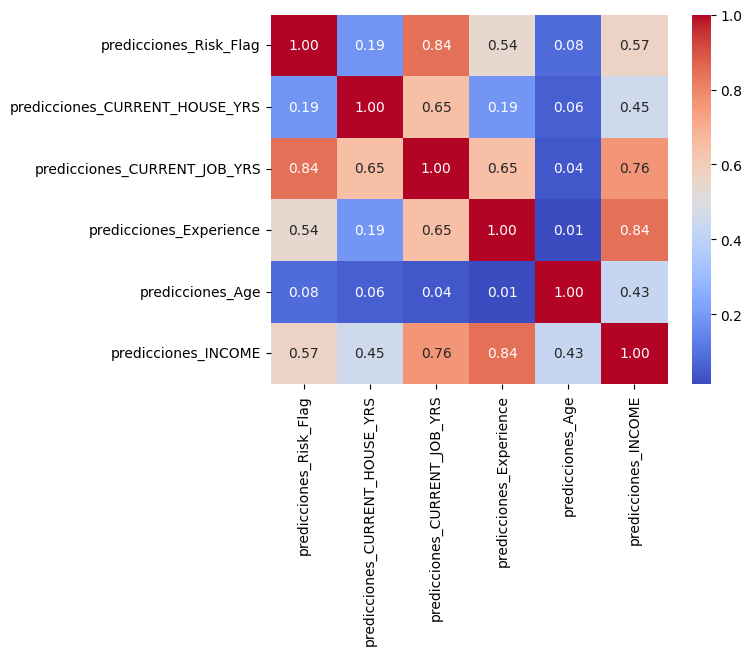

In [ ]:
# COEFICIENTES DE COORELACIÓN
Heat_Map1 = sns.heatmap(Corr_Factors1, cmap = 'coolwarm', annot = True, fmt = '.2f')
Heat_Map1

<Axes: >

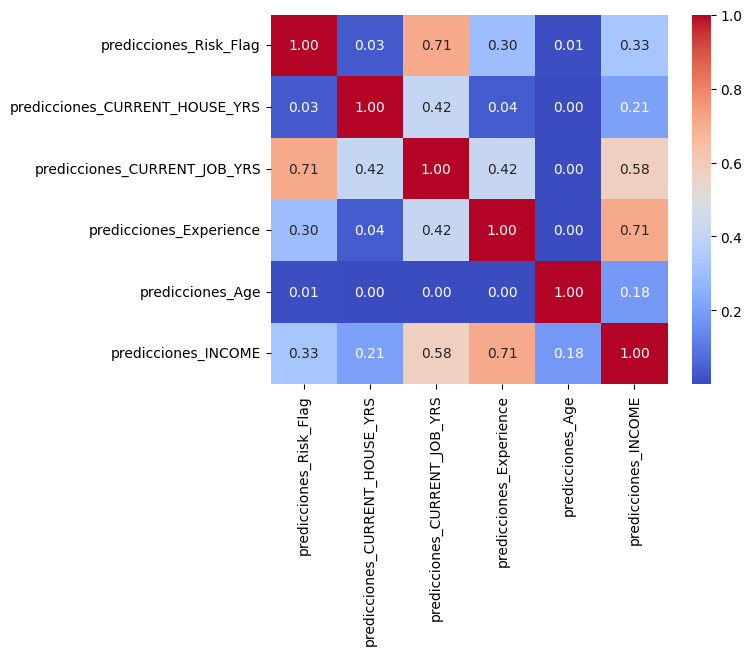

In [ ]:
#COEFICIENTES DE DETERMINACIÓN
Heat_Map12 = sns.heatmap(Corr_Factors1**2, cmap = 'coolwarm', annot = True, fmt = '.2f')
Heat_Map12

#**Modelos NO lineales de las variables cualitativas**

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

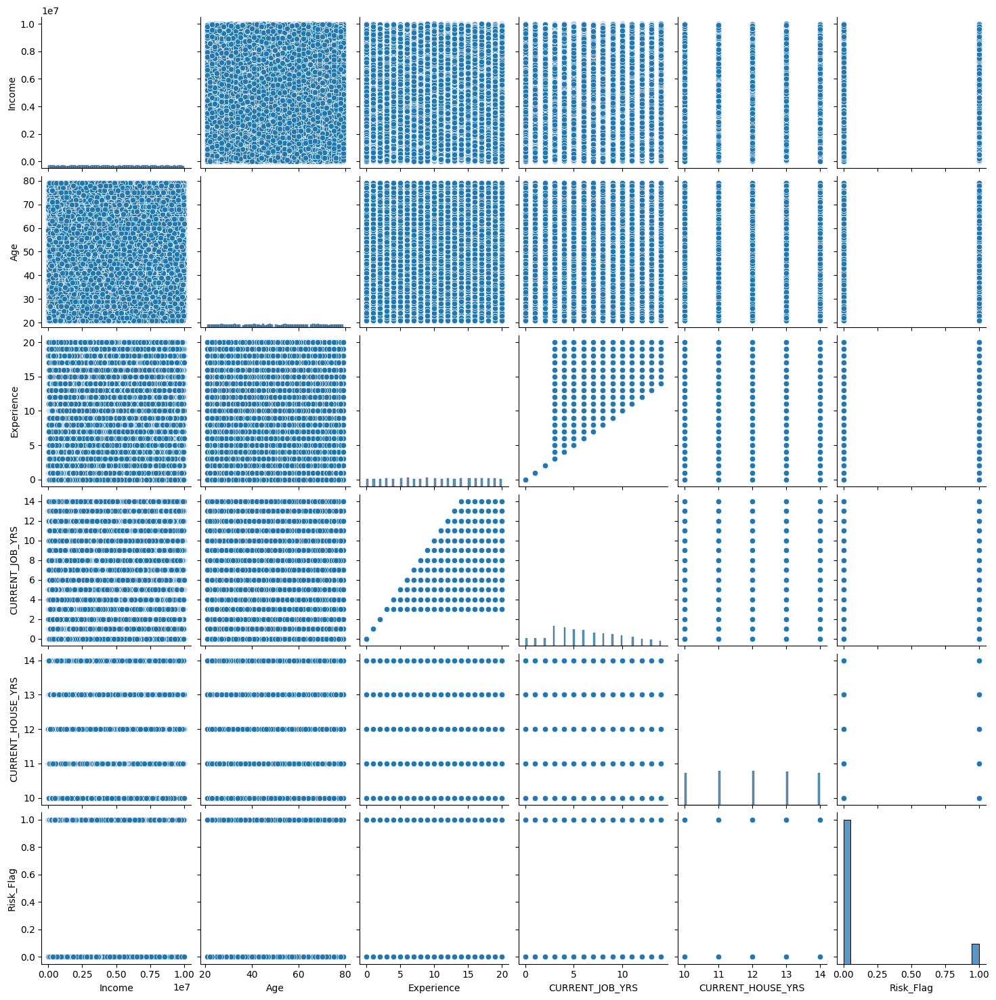

In [ ]:
#Graficamos todas las dispersiones entre todas las variables
sns.pairplot(data2)

In [ ]:
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score

#Income

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Age']]
Var_Dep = data2['Income']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función cociente entre polinomios
def fun2(x, a, b, c):
  return (a*x**16 + b)/ c*x

#Ajustamos los parámetros de la función curve_fit
parametros2, covs2 = curve_fit(fun2, data2['Age'], data2['Income'])
parametros2

array([6.26939898e-13, 3.13130360e+08, 3.49728166e+03])

MODELO 1 PARA INCOME

Income1= 6.26939898e-13 (Age)^16 + 3.13130360e+08 / 3.49728166e+03 (Age)  

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros2, _ = curve_fit(fun2, data2['Age'], data2['Income'])
a, b, c = parametros2[0], parametros2[1], parametros2[2]
yfit1 = (a*x**16 + b)/ c*x

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.5615812839540457

<ipython-input-65-feb7df10db4b>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


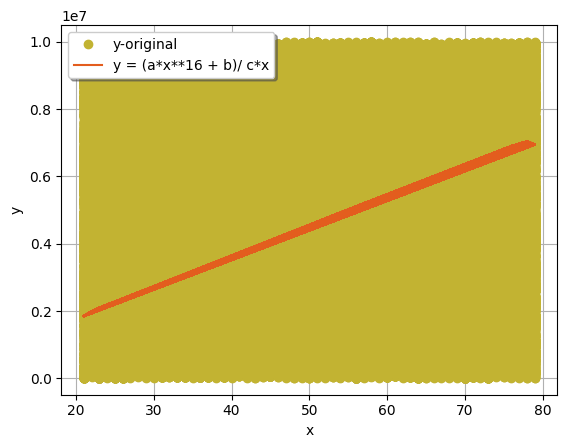

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = (a*x**16 + b)/ c*x', color = '#E35D1E')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Segundo modelo de Income

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Experience']]
Var_Dep = data2['Income']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función cociente entre polinomios
def fun1(x, a, b, c):
  return (a*x**19 + b)/ c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Experience'], data2['Income'])
parametros

array([4.05669955e-15, 2.17256772e+08, 5.92475905e+02])

MODELO 2 PARA INCOME

Income2 = 4.05669955e-15 (Experience)^16 + 2.17256772e+08 / 5.92475905e+02 (Experience)  

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Experience'], data2['Income'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = (a*x**19 + b)/ c*x

#Creamos un data frame en donde almacenaremos las nuevas predicciones
data4 = pd.DataFrame()
data4.insert(0, 'Ajuste_Income', yfit1)
data4

,Ajuste_Income
0,-1.834376e+18
1,7.039782e+18
2,-3.963198e+17
3,4.956202e+18
4,6.218900e+18
...,...
251995,-2.048291e+18
251996,-2.847291e+18
251997,-4.400680e+18
251998,5.301231e+18


In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.8824549295080588

<ipython-input-70-3346db7ea6dc>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


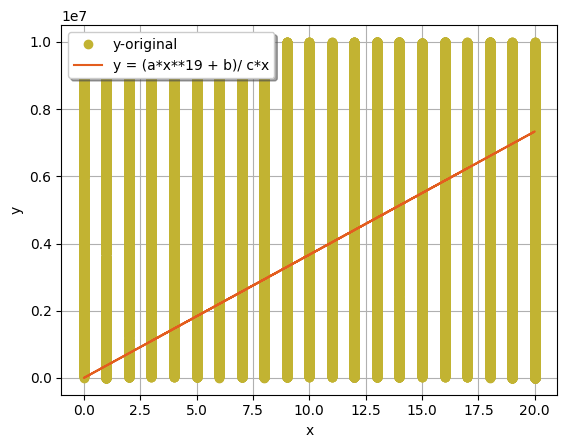

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = (a*x**19 + b)/ c*x', color = '#E35D1E')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Tercer modelo de Income

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['CURRENT_JOB_YRS']]
Var_Dep = data2['Income']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función cociente entre polinomios
def fun1(x, a, b, c):
  return (a*x**20 + b)/ c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Income'])
parametros

array([-2.90904728e-14,  3.22624049e+06,  5.38340215e+00])

MODELO 3 PARA INCOME

Income3 = Income1= -2.90904728e-14 (CURRENT_JOB_YRS)^20 + 3.22624049e+06 / 5.38340215e+00 (CURRENT_JOB_YRS)  

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Income'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = (a*x**20 + b)/ c*x

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.857213821172899

#Age

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['CURRENT_HOUSE_YRS']]
Var_Dep = data2['Age']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función cociente entre polinomios
def fun1(x, a, b, c):
  return (a*x**17 + b)/ c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['CURRENT_HOUSE_YRS'], data2['Age'])
parametros

array([1.40554124e-19, 3.12898733e+01, 7.65391653e+00])

MODELO 1 PARA Age

Age1 = 1.40554124e-19 (Income)^17 + 3.12898733e+01 / 7.65391653e+00 (Income)

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['CURRENT_HOUSE_YRS'], data2['Age'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = (a*x**17 + b)/ c*x

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.351751548399382

<ipython-input-79-6c0cb40f1af5>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


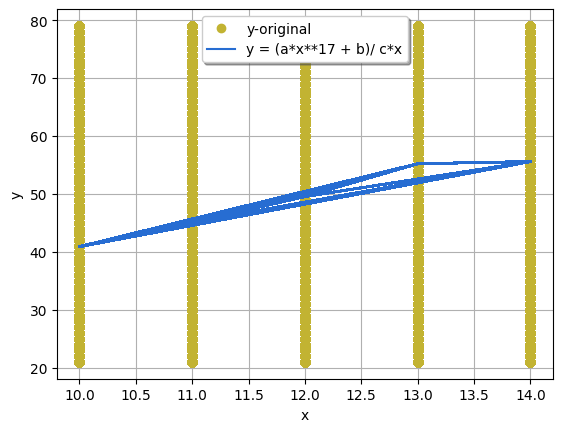

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = (a*x**17 + b)/ c*x', color = '#276DD2')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Segudo modelo para Age

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['CURRENT_JOB_YRS']]
Var_Dep = data2['Age']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return a/b*x**2 + c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Age'])
parametros

array([-0.51996886,  0.60653883, 14.27229173])

MODELO 2 PARA Age

Age = -0.51996886/0.60653883 * (CURRENT_JOB_YRS)^2 + 14.27229173 * CURRENT_JOB_YRS

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Age'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = a/b*x**2 + c*x

data4.insert(0, 'Ajuste_Age', yfit1)
data4

,Ajuste_Age,Ajuste_Income
0,35.101426,1.100079e+06
1,59.011580,3.666352e+06
2,43.372812,1.466772e+06
3,25.115495,7.333860e+05
4,35.101426,4.034061e+06
...,...,...
251995,54.771952,4.767421e+06
251996,54.771952,3.666352e+06
251997,57.899706,2.566852e+06
251998,0.000000,0.000000e+00


In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.9643424135338059

<ipython-input-84-50e731c5555c>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


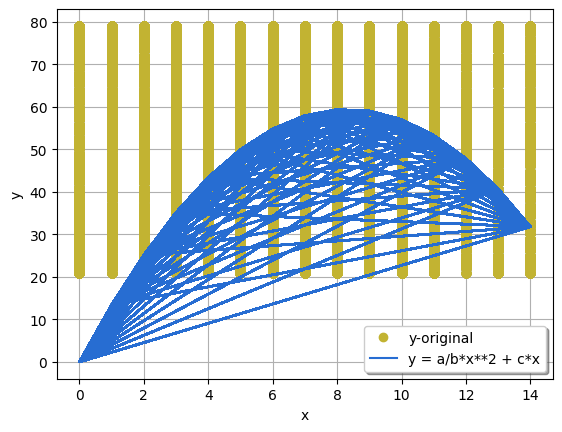

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = a/b*x**2 + c*x', color = '#276DD2')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Tercer modelo para Age

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['CURRENT_JOB_YRS']]
Var_Dep = data2['Age']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b):
  return a*np.sin(x) + b

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Age'])
parametros

array([ 0.1120773 , 49.95694342])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Age'])
a, b = parametros[0], parametros[1]
yfit1 = a*np.sin(x) + b

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.004506118516246894

<ipython-input-89-50e731c5555c>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


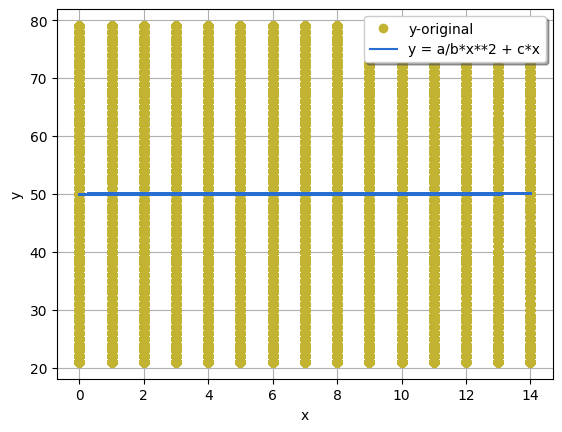

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = a/b*x**2 + c*x', color = '#276DD2')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

#Experience

Primer modelo para Experience

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['CURRENT_JOB_YRS']]
Var_Dep = data2['Experience']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return a/b*x**2 + c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Experience'])
parametros

array([-2.01835983, 22.00841646,  2.35336981])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Experience'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = a/b*x**2 + c*x

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.6713917215124037

<ipython-input-94-fa41ba9353ca>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


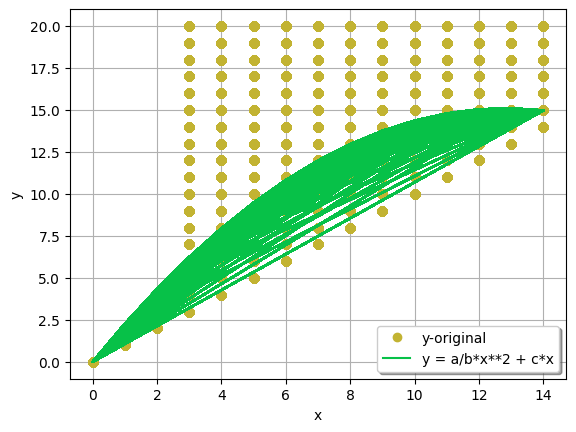

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = a/b*x**2 + c*x', color = '#07C148')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Segundo modelo para Experience

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Age']]
Var_Dep = data2['Experience']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return (a*x**15 + b)/ c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Age'], data2['Experience'])
parametros

array([-2.78580717e-18,  7.49387862e+02,  4.11816981e+03])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Age'], data2['Experience'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = (a*x**15 + b)/ c*x

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.5433726366879322

<ipython-input-99-a8080ebaf431>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


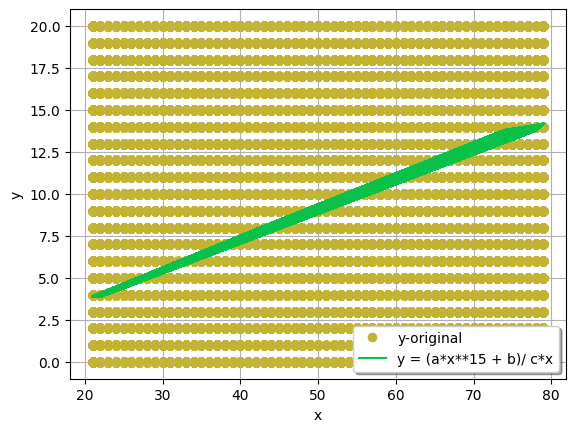

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = (a*x**15 + b)/ c*x', color = '#07C148')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Tercer modelo para Experience

Experience = 1 / 382.39569028 * (Age)^2

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Age']]
Var_Dep = data2['Experience']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a):
  return 1/a*x**2

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Age'], data2['Experience'])
parametros

array([382.39569028])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Age'], data2['Experience'])
a = parametros[0]
yfit1 = 1/a*x**2

data4.insert(0, 'Ajuste_Experience', yfit1)
data4

,Ajuste_Experience,Ajuste_Age,Ajuste_Income
0,1.383384,35.101426,1.100079e+06
1,4.184148,59.011580,3.666352e+06
2,11.391342,43.372812,1.466772e+06
3,4.395970,25.115495,7.333860e+05
4,5.776739,35.101426,4.034061e+06
...,...,...,...
251995,4.835306,54.771952,4.767421e+06
251996,1.767802,54.771952,3.666352e+06
251997,5.533535,57.899706,2.566852e+06
251998,5.295562,0.000000,0.000000e+00


In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.8861233786995323

<ipython-input-104-e2af2499b458>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


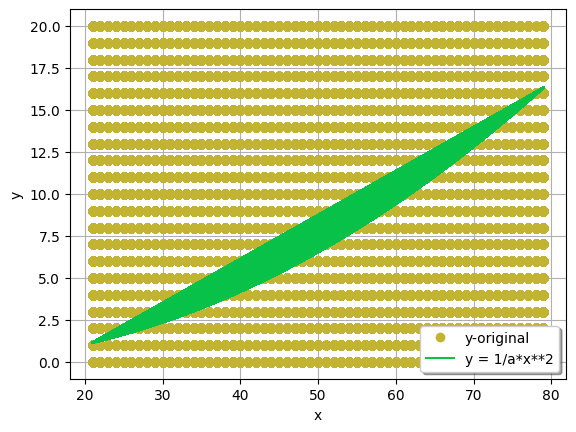

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = 1/a*x**2', color = '#07C148')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

#CURRENT_JOB_YRS

Primer modelo para CURRENT_JOB_YRS

CURRENT_JOB_YRS = 1/ 607.74108478 * (Age)^2

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Age']]
Var_Dep = data2['CURRENT_JOB_YRS']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a):
  return 1/a*x**2

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Age'], data2['CURRENT_JOB_YRS'])
parametros

array([607.74108478])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Age'], data2['CURRENT_JOB_YRS'])
a = parametros[0]
yfit1 = 1/a*x**2

data4.insert(0, 'Ajuste_CURRENT_JOB_YRS', yfit1)
data4

,Ajuste_CURRENT_JOB_YRS,Ajuste_Experience,Ajuste_Age,Ajuste_Income
0,0.870436,1.383384,35.101426,1.100079e+06
1,2.632700,4.184148,59.011580,3.666352e+06
2,7.167526,11.391342,43.372812,1.466772e+06
3,2.765981,4.395970,25.115495,7.333860e+05
4,3.634772,5.776739,35.101426,4.034061e+06
...,...,...,...,...
251995,3.042414,4.835306,54.771952,4.767421e+06
251996,1.112316,1.767802,54.771952,3.666352e+06
251997,3.481746,5.533535,57.899706,2.566852e+06
251998,3.332011,5.295562,0.000000,0.000000e+00


In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.9117617132546574

<ipython-input-109-df082fb1d2a1>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


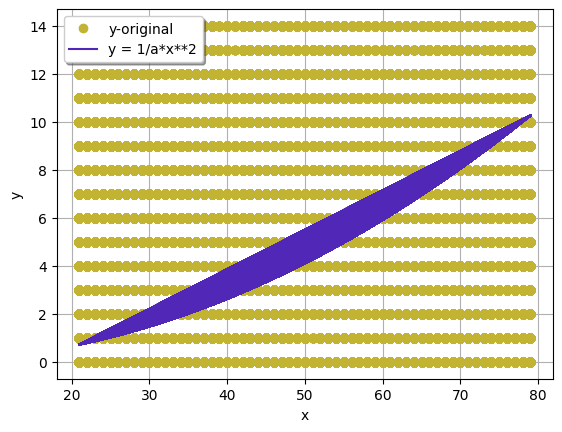

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = 1/a*x**2', color = '#5127B8')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Segundo modelo para CURRENT_JOB_YRS

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Experience']]
Var_Dep = data2['CURRENT_JOB_YRS']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return a/b*x**2 + c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Experience'], data2['CURRENT_JOB_YRS'])
parametros

array([-0.05993341,  1.63448371,  1.12898145])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Experience'], data2['CURRENT_JOB_YRS'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = a/b*x**2 + c*x

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.7235113807911695

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = a/b*x**2 + c*x', color = '#5127B8')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

<ipython-input-114-527d5b6c0b30>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


Tercer modelo para CURRENT_JOB_YRS

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Experience']]
Var_Dep = data2['CURRENT_JOB_YRS']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return a*x**5 + b*x**8 + c*x**3

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Experience'], data2['CURRENT_JOB_YRS'])
parametros

array([-5.05789778e-05,  2.95260716e-09,  1.19903842e-02])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Experience'], data2['CURRENT_JOB_YRS'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = a*x**5 + b*x**8 + c*x**3

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.502118244517659

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y = a*x**5 + b*x**8 + c*x**3', color = '#5127B8')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

#CURRENT_HOUSE_YRS

Primer modelo para CURRENT_HOUSE_YRS

CURRENT_HOUSE_YRS = 0.11873093 / 24.5326461 * (CURRENT_HOUSE_YRS)^2 + 0.50714925 * (CURRENT_HOUSE_YRS)

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Age']]
Var_Dep = data2['CURRENT_HOUSE_YRS']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return a/b*x**2 + c*x

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Age'], data2['CURRENT_HOUSE_YRS'])
parametros

array([-0.11873093, 24.5326461 ,  0.50714925])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Age'], data2['CURRENT_HOUSE_YRS'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = a/b*x**2 + c*x

data4.insert(0, 'Ajuste_CURRENT_HOUSE_YRS', yfit1)
data4

,Ajuste_CURRENT_HOUSE_YRS,Ajuste_Income
0,9.104225,-1.834376e+18
1,12.542431,7.039782e+18
2,12.390067,-3.963198e+17
3,12.657564,4.956202e+18
4,13.145092,6.218900e+18
...,...,...
251995,12.858791,-2.048291e+18
251996,9.914236,-2.847291e+18
251997,13.088036,-4.400680e+18
251998,13.021300,5.301231e+18


In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.965917325036557

<ipython-input-17-056b6c6922ad>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')


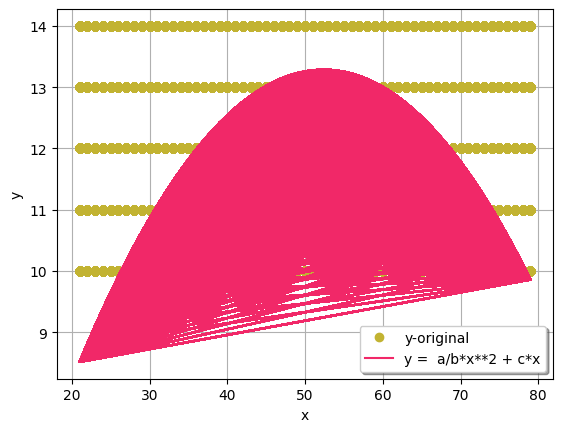

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y =  a/b*x**2 + c*x', color = '#F12868')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Segundo modelo para CURRENT_HOUSE_YRS

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['CURRENT_JOB_YRS']]
Var_Dep = data2['CURRENT_HOUSE_YRS']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return a*x**20 + b*x**10 + c

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['CURRENT_HOUSE_YRS'])
parametros

array([2.28820457e-21, 2.70249137e-13, 1.19918362e+01])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['CURRENT_HOUSE_YRS'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = a*x**20 + b*x**10 + c

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.01114334049871658

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'y =  a*x**20 + b*x**10 + c', color = '#F12868')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Tercer modelo de CURRENT_HOUSE_YRS

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Income']]
Var_Dep = data2['CURRENT_HOUSE_YRS']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b, c):
  return a*np.abs(x**10) + b*x**2 + c

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Income'], data2['CURRENT_HOUSE_YRS'])
parametros

array([-3.92646886e-21, -6.18931433e-17,  1.20177733e+01])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Income'], data2['CURRENT_HOUSE_YRS'])
a, b, c = parametros[0], parametros[1], parametros[2]
yfit1 = a*np.abs(x**10) + b*x**2 + c

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.007679758205998837

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#C2B332')
plt.plot(x, yfit1, label = 'a*np.abs(x**10) + b*x**2 + c', color = '#F12868')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

#Risk_Flag

Primer modelo de Risk_Flag

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Income']]
Var_Dep = data2['Risk_Flag']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b):
  return a*np.sin(x**100) + b

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Income'], data2['Risk_Flag'])
parametros

array([0.00444505, 0.12300352])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Income'], data2['Risk_Flag'])
a, b = parametros[0], parametros[1]
yfit1 = a*np.sin(x**100) + b

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.0067939279123642275

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#2883F1')
plt.plot(x, yfit1, label = 'a*np.sin(x**100) + b', color = '#C2B332')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Segundo modelo de Risk_Flag

Risk_Flag = 0.00716136 * log((Risk_Flag)^3) + 0.20561261

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['Age']]
Var_Dep = data2['Risk_Flag']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b):
  return a*np.log(x**3) + b

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['Age'], data2['Risk_Flag'])
parametros

array([-0.00716136,  0.20561261])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['Age'], data2['Risk_Flag'])
a, b = parametros[0], parametros[1]
yfit1 = a*np.log(x**3) + b

data4.insert(0, 'Ajuste_Risk_Flag', yfit1)
data4

,Ajuste_Risk_Flag,Ajuste_CURRENT_HOUSE_YRS,Ajuste_Income
0,0.138249,9.104225,-1.834376e+18
1,0.126360,12.542431,7.039782e+18
2,0.115602,12.390067,-3.963198e+17
3,0.125830,12.657564,4.956202e+18
4,0.122896,13.145092,6.218900e+18
...,...,...,...
251995,0.124807,12.858791,-2.048291e+18
251996,0.135615,9.914236,-2.847291e+18
251997,0.123358,13.088036,-4.400680e+18
251998,0.123830,13.021300,5.301231e+18


In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.02456624517219312

<ipython-input-22-b1840b840e33>:2: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  plt.plot(x, y, 'bo', label = 'y-original', color = '#2883F1')


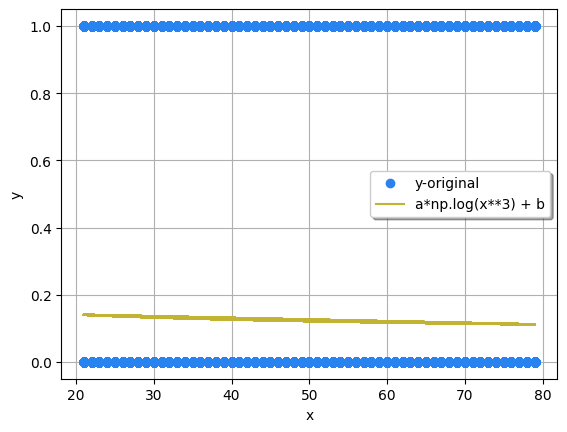

In [ ]:
#Graficamos las predicciones y los datos originales para realizar la comparación
plt.plot(x, y, 'bo', label = 'y-original', color = '#2883F1')
plt.plot(x, yfit1, label = 'a*np.log(x**3) + b', color = '#C2B332')
plt.xlabel('x')
plt.ylabel('y')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

Tercer modelo de Risk_Flag

In [ ]:
#declaramos la variables dependientes e independientes
Var_Indep = data2[['CURRENT_JOB_YRS']]
Var_Dep = data2['Risk_Flag']

#Redefinimos las variables
x = Var_Indep
y = Var_Dep

In [ ]:
#Función polinomial inversa
def fun1(x, a, b):
  return a*np.tan(x) + b

#ajustamos los parámetros de la funcion cirve_fit
parametros, covs = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Risk_Flag'])
parametros

array([-4.41303910e-05,  1.22439301e-01])

In [ ]:
#creamos el modelo de prediccion con los parametros obtenidos
parametros, _ = curve_fit(fun1, data2['CURRENT_JOB_YRS'], data2['Risk_Flag'])
a, b = parametros[0], parametros[1]
yfit1 = a*np.tan(x) + b

In [ ]:
#calculamos el coeficiente de determinación del modelo
R2 = r2_score(y, yfit1)
absoluto = abs(R2)
corre = absoluto**(1/2)
corre

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(

0.006850076007208478

In [ ]:
Corr_Factors1 = data4.corr()
Corr_Factors1 = abs(Corr_Factors1)

<Axes: >

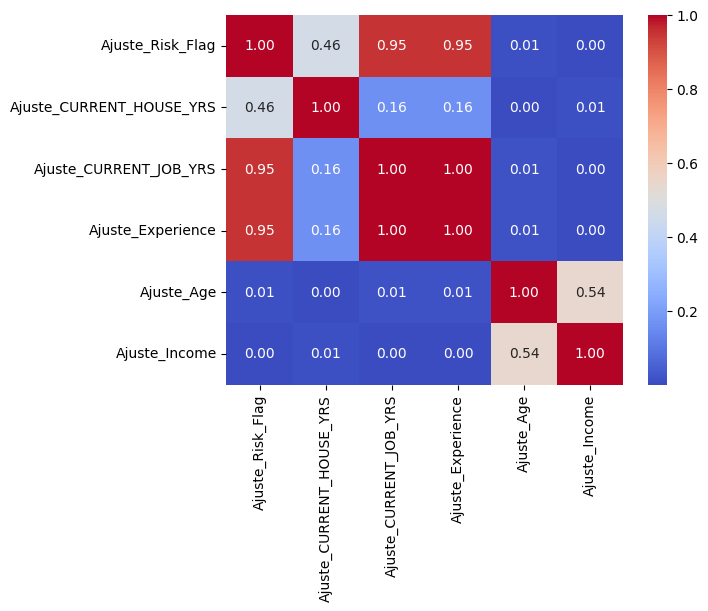

In [ ]:
# COEFICIENTES DE COORELACIÓN
Heat_Map1 = sns.heatmap(Corr_Factors1, cmap = 'coolwarm', annot = True, fmt = '.2f')
Heat_Map1

<Axes: >

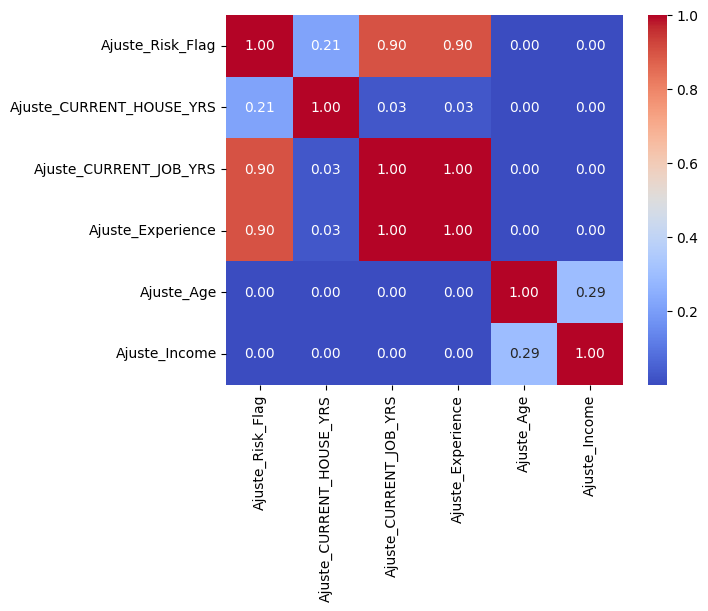

In [ ]:
#COEFICIENTES DE DETERMINACIÓN
Heat_Map12 = sns.heatmap(Corr_Factors1**2, cmap = 'coolwarm', annot = True, fmt = '.2f')
Heat_Map12